## 餐馆聚类分析

In [1]:
# 导入需要的包
import numpy as np
import pandas as pd
import warnings
warnings.simplefilter("ignore")

### 0. 加载数据

In [2]:
# 加载biz数据集

biz_data = pd.read_csv("./data/biz_data.csv")
biz_data.head()

,business_id,name,neighborhood,address,postal_code,latitude,longitude,stars,review_count,is_open,categories
0,qim0lD112TkDhm8ZyQlRnA,McCarthy's Irish Pub,Upper Beach,1801 Gerrard Street E,M4L 2B5,43.678049,-79.314774,4.0,5,0,"Pubs,Bars,Irish,Nightlife"
1,Wf5C8Amv_SlhoYE3_W66WQ,Oishi Sushi,NaN,1325 Finch Ave W,M3J 2G5,43.763510,-79.490750,2.0,27,0,"Asian Fusion,Sushi Bars"
2,Z1r6b30Tg0n0ME4-Zj2wQQ,Boardwalk Place,NaN,1675 Lake Shore Boulevard E,M4W 3L6,43.663010,-79.310898,3.0,13,1,"American (Traditional),Bars,Pubs,Beer,Wine & S..."
3,oMcKvfNGX2HleFxYg1VGqg,Buonanotte,Entertainment District,19 Mercer Street,M5V 1H2,43.645687,-79.390493,2.0,66,1,Italian
4,kLw_FmSiEqYH-MtFhDIUFQ,Big Daddy's Bourbon Street Bistro & Oyster Bar,Entertainment District,212 King Street W,M5H 1K5,43.647499,-79.386471,3.5,132,0,"Cajun/Creole,Seafood"


### 1. 数据预处理

In [3]:
# 查看数据集缺失情况
missing_values_count = biz_data.isnull().sum()
print(missing_values_count)

business_id        0
name               0
neighborhood    1142
address           14
postal_code       16
latitude           0
longitude          0
stars              0
review_count       0
is_open            0
categories        12
dtype: int64


In [4]:
# 删除属性categories为空的行
biz_data = biz_data.dropna(subset = ['categories'])

In [6]:
#!pip install nltk
import nltk
#nltk.download('stopwords')
#nltk.download('punkt')
#nltk.download('wordnet')


In [8]:
# 对属性categories进行分词、删除停顿词、提取词干等处理

import nltk 
import string
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer 

stop_words = nltk.corpus.stopwords.words('english') + ['food']

def Preprocessing(text):

    text = text.lower() # 将所有的单词转换成小写字母

    for c in string.punctuation:
        text = text.replace(c," ")  # 将标点符号转换成空格

    wordList = nltk.word_tokenize(text)  # 分词

    filtered = [w for w in wordList if w not in stop_words] # 删除停顿词

    # stem 
    ps = PorterStemmer()
    filtered = [ps.stem(w) for w in filtered]  # 提取词干
    wl = WordNetLemmatizer()   
    filtered = [wl.lemmatize(w) for w  in filtered]  # 词形还原

    return " ".join(filtered)

biz_data['category_preprocessed'] = biz_data['categories'].apply(lambda x: Preprocessing(x))
biz_data.head()

,business_id,name,neighborhood,address,postal_code,latitude,longitude,stars,review_count,is_open,categories,category_preprocessed
0,qim0lD112TkDhm8ZyQlRnA,McCarthy's Irish Pub,Upper Beach,1801 Gerrard Street E,M4L 2B5,43.678049,-79.314774,4.0,5,0,"Pubs,Bars,Irish,Nightlife",pub bar irish nightlif
1,Wf5C8Amv_SlhoYE3_W66WQ,Oishi Sushi,NaN,1325 Finch Ave W,M3J 2G5,43.763510,-79.490750,2.0,27,0,"Asian Fusion,Sushi Bars",asian fusion sushi bar
2,Z1r6b30Tg0n0ME4-Zj2wQQ,Boardwalk Place,NaN,1675 Lake Shore Boulevard E,M4W 3L6,43.663010,-79.310898,3.0,13,1,"American (Traditional),Bars,Pubs,Beer,Wine & S...",american tradit bar pub beer wine spirit nightlif
3,oMcKvfNGX2HleFxYg1VGqg,Buonanotte,Entertainment District,19 Mercer Street,M5V 1H2,43.645687,-79.390493,2.0,66,1,Italian,italian
4,kLw_FmSiEqYH-MtFhDIUFQ,Big Daddy's Bourbon Street Bistro & Oyster Bar,Entertainment District,212 King Street W,M5H 1K5,43.647499,-79.386471,3.5,132,0,"Cajun/Creole,Seafood",cajun creol seafood


In [9]:
# TFIDF --特征向量化
from sklearn.feature_extraction.text import TfidfVectorizer

X_category = biz_data['category_preprocessed'].values
tfidf_vec = TfidfVectorizer()
X_category = tfidf_vec.fit_transform(X_category)

X_category.shape

(6738, 356)

In [10]:
# PCA降维处理
from sklearn.decomposition import PCA

pca = PCA(n_components = 0.95, random_state = 42)
X_category_pca = pca.fit_transform(X_category.toarray())

X_category_pca.shape

(6738, 99)

### 聚类分析

#### 1. 只使用经过文本预处理后的餐馆类别数据对餐馆进行聚类

 - K-Means

In [11]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import folium
import os
import seaborn as sns
from sklearn.cluster import DBSCAN

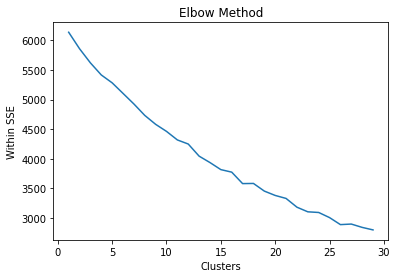

In [30]:
# 选择合适的k值

# 肘部法
sse = []
cluster_list = range(1, 30)
for i in cluster_list :
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    kmeans.fit(X_category_pca)
    sse.append(kmeans.inertia_)
plt.plot(cluster_list, sse)
plt.title('Elbow Method')
plt.xlabel('Clusters')
plt.ylabel('Within SSE')
plt.show()

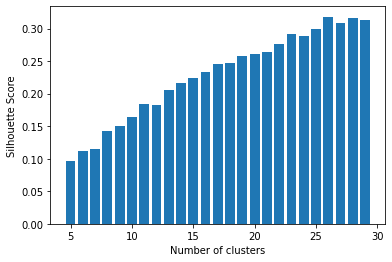

In [29]:
# 轮廓法

s = [] 
cluster_list = range(5, 30)
for i in cluster_list:
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    s.append(silhouette_score(X_category_pca, kmeans.fit_predict(X_category_pca))) 
    
# Plotting a bar graph to compare the results 
plt.bar(cluster_list, s) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()

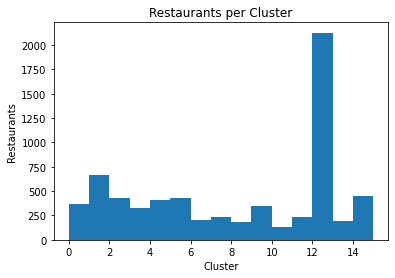

In [23]:
# 选择k值为15

kmeans = KMeans(n_clusters = 15, random_state = 2021) 
labels = kmeans.fit_predict(X_category_pca)
biz_data["cluster1"] = labels

# plot cluster sizes
plt.hist(labels, bins = range(16))
plt.title ('Restaurants per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Restaurants')
plt.show()

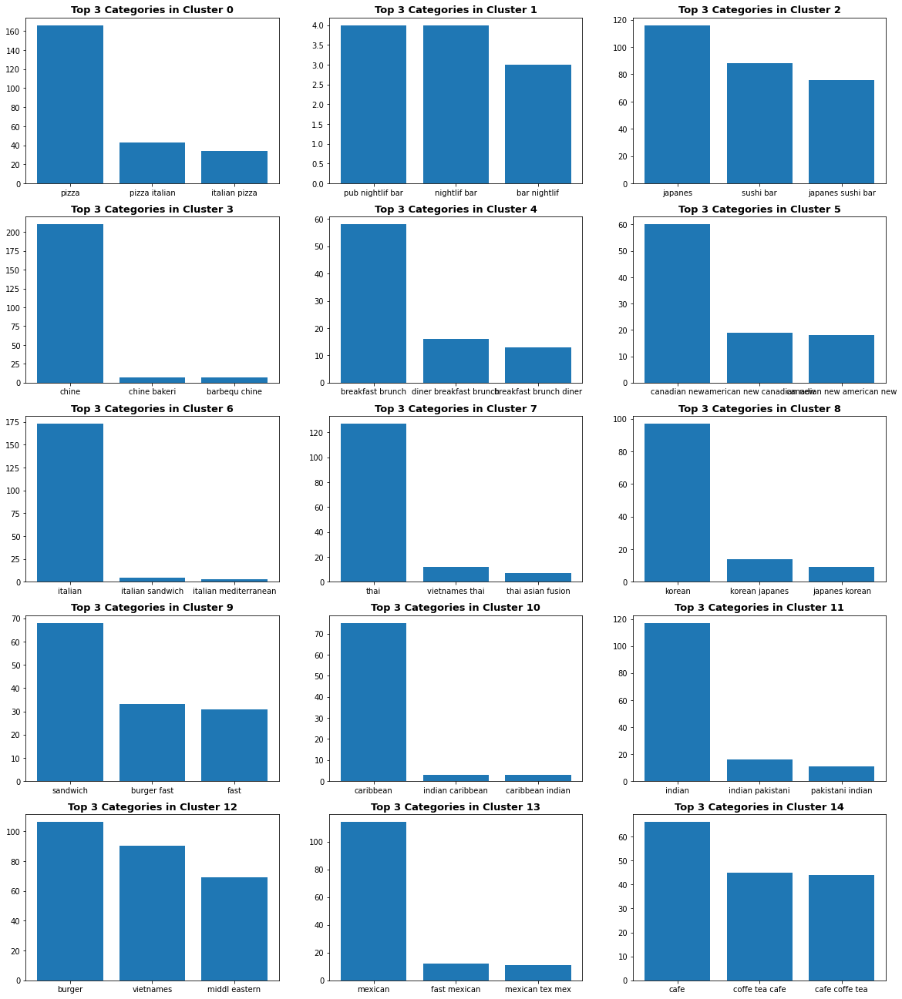

In [24]:
# 聚类结果展示，查看每个簇中排名前3的categories属性

plt.figure(figsize = (20, 23))
for i in range(0, 15):
    cluster_data = biz_data[biz_data['cluster1'] == i]
    category_str = ','.join(cluster_data['category_preprocessed'])
    category_list = category_str.split(',')
    category_df = pd.DataFrame(category_list, columns = ['category'])
    top3_category = category_df['category'].value_counts()[:3]
    plt.subplot(5,3,i+1)
    plt.bar(top3_category.index,top3_category)
    plt.title('Top 3 Categories in Cluster ' + str(i), fontsize = 13, fontweight = 'bold')
    
plt.show()
    

根据上图可得，聚类结果与餐馆类别属性具有较强相关性，如，簇0中主要是披萨，簇1主要是酒吧，簇2主要是日式料理...

In [25]:
biz_data.to_csv("./data/biz_with_cluster.csv", index = False)

In [26]:
# 按聚类结果在地图上展示餐馆信息

# Create map and display it
# 多伦多经纬度
latitude = 43.66
longitude = -79.38

trt_map = folium.Map(location=[latitude, longitude], zoom_start = 12)

colors = ['#5938B0', '#50329E', '#472D8D', '#3E277B', '#35226A', '#F0F8FF', '#F0FFFF', '#A52A2A', '#FF8C00', '#483D8B', '#FF00FF',
         '#FFD700', '#FF69B4', '#00FF00', '#9370DB']
for name, row in biz_data.iterrows():
    i = row['cluster1']
    folium.CircleMarker( 
        [row['latitude'],row['longitude']],
        radius=4,  # define how big you want the circle markers to be
        color=colors[i],
        fill=False).add_to(trt_map) 
    
trt_map

 未考虑餐馆地理位置信息，聚类结果在地理位置上呈现出无关性

#### 2. 使用餐馆类别数据 + (review_count,stars, is_open)数据进行聚类

- 2.1 K-Means

In [27]:
biz_data_selected = pd.DataFrame(biz_data[['stars', 'review_count', 'is_open']])

standardscaler = StandardScaler()
biz_data_s = standardscaler.fit_transform(biz_data_selected)

# 合并类别数据和review_count等数据
train_data = np.concatenate((biz_data_s, X_category_pca), axis = 1)
train_data.shape

(6738, 102)

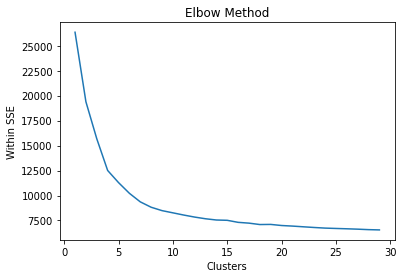

In [31]:
# 选择合适的k值

# 肘部法
sse = []
cluster_list = range(1, 30)
for i in cluster_list :
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    kmeans.fit(train_data)
    sse.append(kmeans.inertia_)
plt.plot(cluster_list, sse)
plt.title('Elbow Method')
plt.xlabel('Clusters')
plt.ylabel('Within SSE')
plt.show()

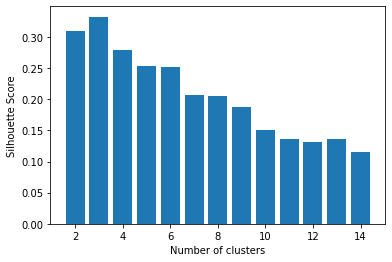

In [32]:
# 轮廓法

s = [] 
cluster_list = range(2, 15)
for i in cluster_list:
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    s.append(silhouette_score(train_data, kmeans.fit_predict(train_data))) 
    
# Plotting a bar graph to compare the results 
plt.bar(cluster_list, s) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()

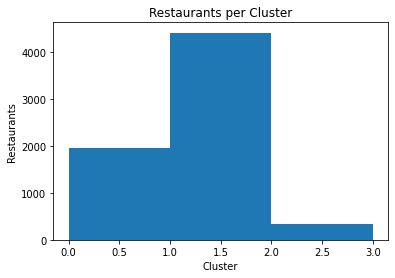

In [33]:
# 选择k值为3

kmeans = KMeans(n_clusters = 3, random_state = 2021) 
labels = kmeans.fit_predict(train_data)
biz_data["cluster2"] = labels
# plot cluster sizes
plt.hist(labels, bins = range(4))
plt.title ('Restaurants per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Restaurants')
plt.show()

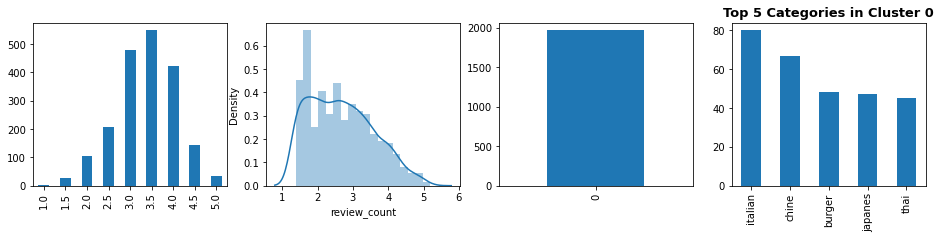

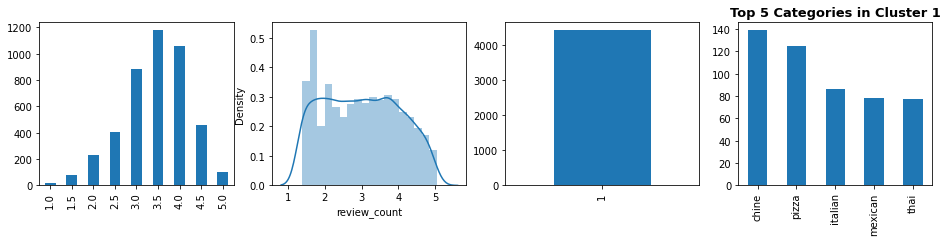

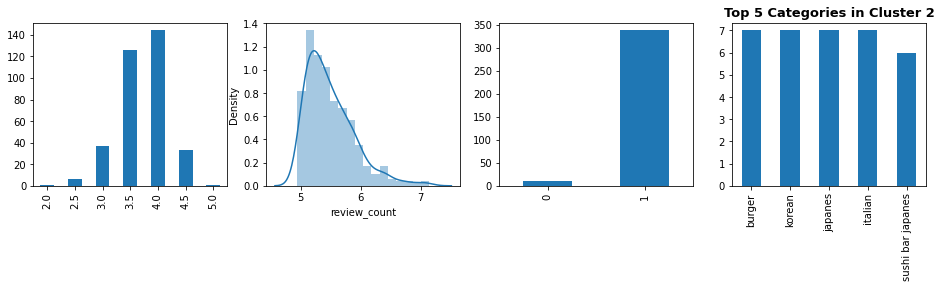

In [36]:
# 聚类结果展示，查看每个簇中各属性的取值分布情况
for i in range(0,3):
    cluster_data = biz_data[biz_data['cluster2'] == i]
    
    plt.figure(figsize=(16,3))
    stars_count = cluster_data["stars"].value_counts().sort_index()
    plt.subplot(141)
    stars_count.plot.bar()
    
    plt.subplot(142)
    sns.distplot(cluster_data.review_count.apply(np.log1p))
    is_open_count = cluster_data["is_open"].value_counts().sort_index()
    
    plt.subplot(143)
    is_open_count.plot.bar()
    
    category_str = ','.join(cluster_data['category_preprocessed'])
    category_list = category_str.split(',')
    category_df = pd.DataFrame(category_list, columns = ['category'])
    top5_category = category_df['category'].value_counts()[:5]
    plt.subplot(144)
    top5_category.plot.bar()
    plt.title('Top 5 Categories in Cluster '+str(i),
          fontsize=13, 
          fontweight='bold')
    
    plt.show()

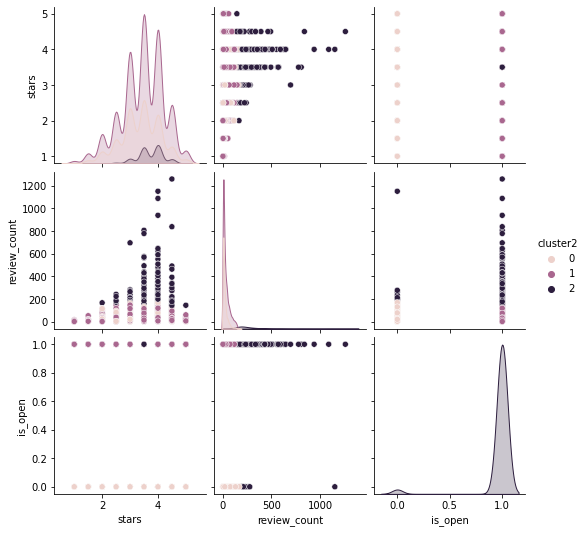

In [37]:
imp_cols = ['stars', 'review_count', 'is_open']
imp_cols.append("cluster2")
sns.pairplot(biz_data[imp_cols], hue = "cluster2")

 由上述分析可得，此聚类结果主要与餐馆是否开门(is_open)、评论数量(review_count)有关，簇0主要是不开门且评论数较少的餐馆，簇1主要是开门且评论数较少的餐馆,簇2主要是开门且评论数较多的餐馆。餐馆的category对分类结果没有太大的影响。

In [38]:
# 按聚类结果在地图上展示餐馆信息

trt_map = folium.Map(location=[latitude, longitude], zoom_start = 12)

colors = ['royalblue', 'yellow', 'red']

for name, row in biz_data.iterrows():
    i = row['cluster2']
    folium.CircleMarker( 
        [row['latitude'], row['longitude']],
        radius = 4,  # define how big you want the circle markers to be
        color = colors[i],
        fill = False).add_to(trt_map) 
    
trt_map

 未考虑地理信息，聚类结果与地理位置无关

- 2.2 DBSCAN

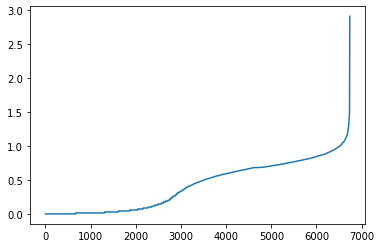

In [39]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors = 8)
nbrs = neigh.fit(train_data)
distances, indices = nbrs.kneighbors(train_data)
distances = np.sort(distances, axis = 0)
distances = distances[:,1]
plt.plot(distances)

In [40]:
s = []
for eps in np.arange(0.8, 1.5, 0.1):
    for min_sample in range(2, 10):
        dbscan = DBSCAN(eps = eps, min_samples = min_sample)
        dbscan.fit(train_data)
        sil_score = silhouette_score(train_data, dbscan.labels_, metric = 'euclidean')
        s.append((eps, min_sample, sil_score, len(set(dbscan.labels_))))
        
df_dbscan = pd.DataFrame(s, columns = ['eps', 'min_samples', 'sil_score', 'number_of_clusters'])

In [41]:
df_dbscan.sort_values('sil_score', ascending = False).head()

,eps,min_samples,sil_score,number_of_clusters
31,1.1,9,0.319132,3
30,1.1,8,0.318961,3
29,1.1,7,0.318529,3
35,1.2,5,0.317905,3
36,1.2,6,0.317625,3


In [42]:
dbscan = DBSCAN(eps = 1.1, min_samples = 9)
labels = dbscan.fit_predict(train_data)

biz_data["cluster3"] = labels
print(biz_data["cluster3"].value_counts())

biz_data.head()

 1    4576
 0    1925
-1     237
Name: cluster3, dtype: int64


,business_id,name,neighborhood,address,postal_code,latitude,longitude,stars,review_count,is_open,categories,category_preprocessed,cluster1,cluster2,cluster3
0,qim0lD112TkDhm8ZyQlRnA,McCarthy's Irish Pub,Upper Beach,1801 Gerrard Street E,M4L 2B5,43.678049,-79.314774,4.0,5,0,"Pubs,Bars,Irish,Nightlife",pub bar irish nightlif,1,0,0
1,Wf5C8Amv_SlhoYE3_W66WQ,Oishi Sushi,NaN,1325 Finch Ave W,M3J 2G5,43.763510,-79.490750,2.0,27,0,"Asian Fusion,Sushi Bars",asian fusion sushi bar,2,0,0
2,Z1r6b30Tg0n0ME4-Zj2wQQ,Boardwalk Place,NaN,1675 Lake Shore Boulevard E,M4W 3L6,43.663010,-79.310898,3.0,13,1,"American (Traditional),Bars,Pubs,Beer,Wine & S...",american tradit bar pub beer wine spirit nightlif,1,1,1
3,oMcKvfNGX2HleFxYg1VGqg,Buonanotte,Entertainment District,19 Mercer Street,M5V 1H2,43.645687,-79.390493,2.0,66,1,Italian,italian,6,1,1
4,kLw_FmSiEqYH-MtFhDIUFQ,Big Daddy's Bourbon Street Bistro & Oyster Bar,Entertainment District,212 King Street W,M5H 1K5,43.647499,-79.386471,3.5,132,0,"Cajun/Creole,Seafood",cajun creol seafood,12,0,-1


In [43]:
# 按聚类结果在地图上展示餐馆信息

trt_map = folium.Map(location=[latitude, longitude], zoom_start=12)

colors = ['royalblue', 'yellow', 'red']

for name, row in biz_data.iterrows():
    i = row['cluster3']
    folium.CircleMarker( 
        [row['latitude'],row['longitude']],
        radius=4,  # define how big you want the circle markers to be
        color=colors[i],
        fill=False).add_to(trt_map) 
    
trt_map

 与2.1对比可得，KMeans与DBSCAN方法在此数据集上聚类结果类似

#### 3. 结合餐馆位置信息进行聚类

- K-Means

In [44]:
# 使用经纬度 + category类别数据进行聚类

biz_data_selected = pd.DataFrame(biz_data[['latitude', 'longitude']])

standardscaler = StandardScaler()
biz_data_s = standardscaler.fit_transform(biz_data_selected)

# 合并类别数据和review_count等数据
train_data = np.concatenate((biz_data_s,X_category_pca),axis=1)
train_data.shape

(6738, 101)

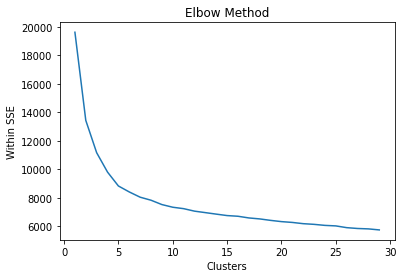

In [46]:
# 选择合适的k值

# 肘部法

sse = []
cluster_list = range(1, 30)
for i in cluster_list :
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    kmeans.fit(train_data)
    sse.append(kmeans.inertia_)
plt.plot(cluster_list, sse)
plt.title('Elbow Method')
plt.xlabel('Clusters')
plt.ylabel('Within SSE')
plt.show()

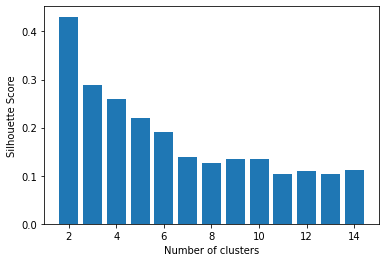

In [47]:
# 轮廓法

from sklearn.metrics import silhouette_score
s = [] 
cluster_list = range(2, 15)
for i in cluster_list:
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    s.append(silhouette_score(train_data, kmeans.fit_predict(train_data))) 
    
# Plotting a bar graph to compare the results 
plt.bar(cluster_list, s) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()

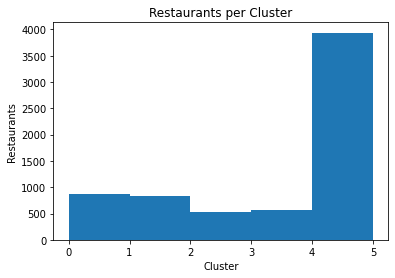

In [48]:
# 选择k值为5，虽然当k=2时轮廓系数最大，但结合实际考虑，k值过小会使聚类效果不好

kmeans = KMeans(n_clusters = 5, random_state = 2021) 
labels = kmeans.fit_predict(train_data)
biz_data["cluster4"] = labels
# plot cluster sizes
plt.hist(labels, bins = range(6))
plt.title ('Restaurants per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Restaurants')
plt.show()

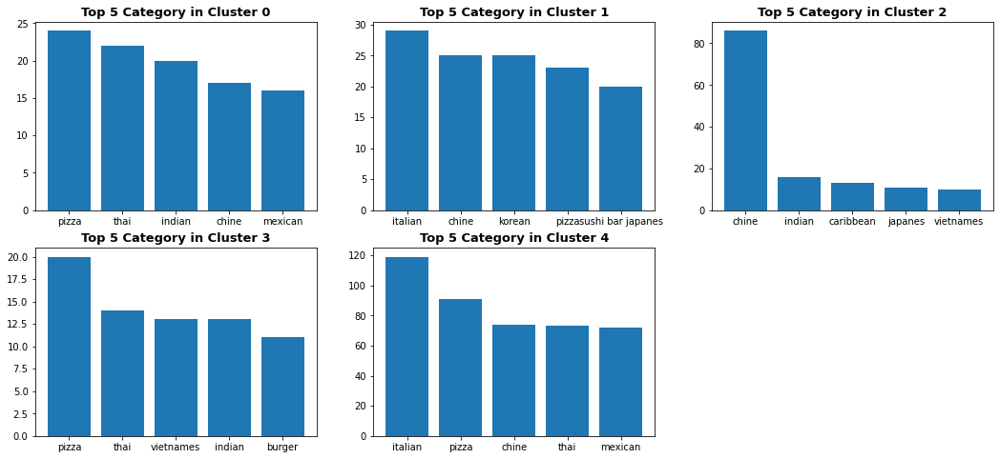

In [49]:
# 聚类结果展示， 查看每个簇中排名前5的categories

plt.figure(figsize = (18, 8))
for i in range(0, 5):
    cluster_data = biz_data[biz_data['cluster4'] == i]
    category_str = ','.join(cluster_data['category_preprocessed'])
    category_list = category_str.split(',')
    category_df = pd.DataFrame(category_list, columns = ['category'])
    top5_category = category_df['category'].value_counts()[:5]
    plt.subplot(2,3,i+1)
    plt.bar(top5_category.index,top5_category)
    plt.title('Top 5 Category in Cluster ' + str(i), fontsize = 13, fontweight = 'bold')
plt.show()

In [50]:
# 按聚类结果在地图上展示餐馆信息

trt_map = folium.Map(location=[latitude, longitude], zoom_start = 12)

colors = ['royalblue', 'yellow', 'red', 'green', 'purple']

for name, row in biz_data.iterrows():
    i = row['cluster4']
    folium.CircleMarker( 
        [row['latitude'], row['longitude']],
        radius = 4,  # define how big you want the circle markers to be
        color = colors[i],
        fill = False).add_to(trt_map) 
    
trt_map

 从上图可得，聚类结果综合考虑了餐馆的类别信息和地理位置信息；如，在簇0和簇3中的餐馆，类别基本相同，主要是披萨、泰国的、印度的，但因为地理位置的影响，餐馆被分为了两个簇（簇0对应上图的蓝色，簇3对应上图的绿色）

#### 4. 使用经纬度+(review_count, stars, is_open) + category数据进行聚类

In [51]:
biz_data_selected = pd.DataFrame(biz_data[['latitude', 'longitude', 'stars', 'review_count', 'is_open']])

standardscaler = StandardScaler()
biz_data_s = standardscaler.fit_transform(biz_data_selected)

# 合并类别数据和review_count等数据
train_data = np.concatenate((biz_data_s, X_category_pca), axis = 1)
train_data.shape

(6738, 104)

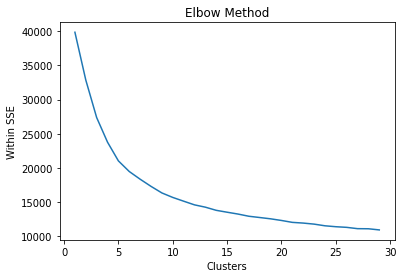

In [52]:
# 选择合适的k值

# 肘部法

sse = []
cluster_list = range(1, 30)
for i in cluster_list :
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    kmeans.fit(train_data)
    sse.append(kmeans.inertia_)
plt.plot(cluster_list, sse)
plt.title('Elbow Method')
plt.xlabel('Clusters')
plt.ylabel('Within SSE')
plt.show()

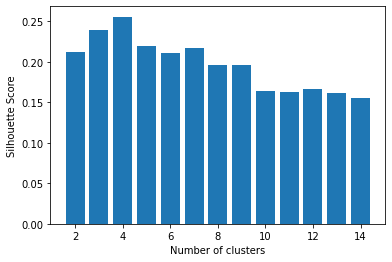

In [53]:
# 轮廓法

s = [] 
cluster_list = range(2, 15)
for i in cluster_list:
    kmeans = KMeans(n_clusters = i, random_state = 2021)
    s.append(silhouette_score(train_data, kmeans.fit_predict(train_data))) 
    
# Plotting a bar graph to compare the results 
plt.bar(cluster_list, s) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()

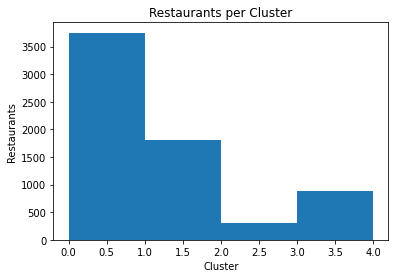

In [54]:
# 选择k值为4

kmeans = KMeans(n_clusters = 4, random_state = 2021) 
labels = kmeans.fit_predict(train_data)
biz_data["cluster6"] = labels
# plot cluster sizes
plt.hist(labels, bins = range(5))
plt.title ('Restaurants per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Restaurants')
plt.show()

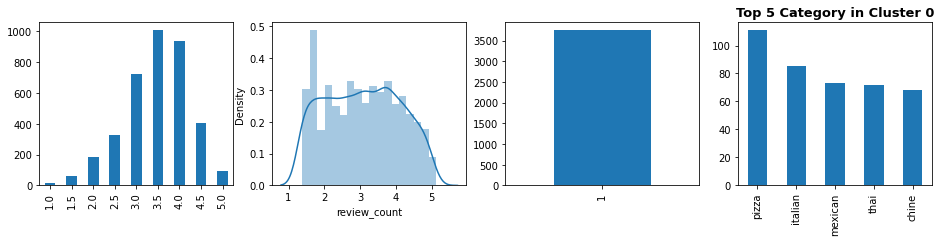

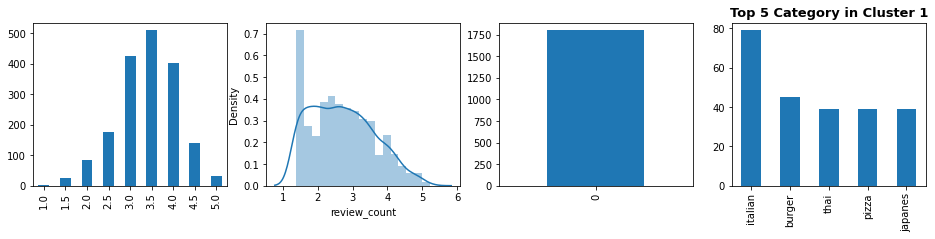

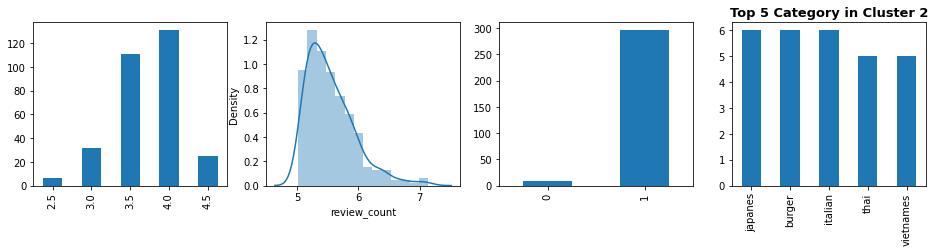

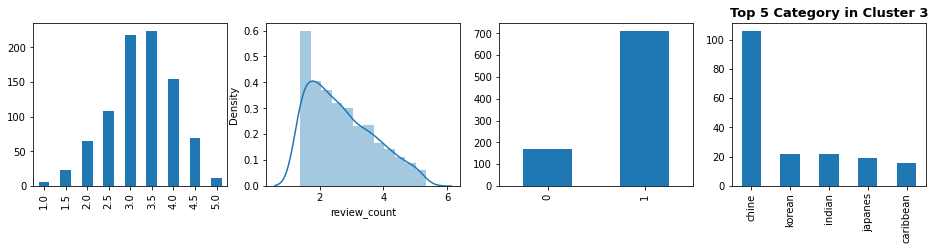

In [55]:
# 聚类结果展示， 查看每个簇中各属性的取值分布情况

for i in range(0, 4):
    cluster_data = biz_data[biz_data['cluster6'] == i]
    
    plt.figure(figsize = (16, 3))
    stars_count = cluster_data["stars"].value_counts().sort_index()
    plt.subplot(141)
    stars_count.plot.bar()
    
    plt.subplot(142)
    sns.distplot(cluster_data.review_count.apply(np.log1p))
    is_open_count = cluster_data["is_open"].value_counts().sort_index()
    
    plt.subplot(143)
    is_open_count.plot.bar()
    
    category_str = ','.join(cluster_data['category_preprocessed'])
    category_list = category_str.split(',')
    category_df = pd.DataFrame(category_list, columns=['category'])
    top5_category = category_df['category'].value_counts()[:5]
    plt.subplot(144)
    top5_category.plot.bar()
    plt.title('Top 5 Category in Cluster '+str(i),
          fontsize=13, 
          fontweight='bold')
    
    plt.show()

聚类得到的4个簇，在stars和review_count属性上的取值分布基本相同，在is_open属性上有所不同，餐馆是否开门对聚类结果有一定的影响；

In [56]:
# 按聚类结果在地图上展示餐馆信息

trt_map = folium.Map(location = [latitude, longitude], zoom_start = 12)

colors = ['royalblue', 'yellow', 'red', 'green']

for name, row in biz_data.iterrows():
    i = row['cluster6']
    folium.CircleMarker( 
        [row['latitude'],row['longitude']],
        radius = 4,  # define how big you want the circle markers to be
        color = colors[i],
        fill = False).add_to(trt_map) 
    
trt_map